In [1]:
#Importing all libraries used in lessons covering this project; just in case I need any of them 
import os
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import cv2
import glob
import pickle

# Camera Calibration - Compute Calibration Matrix and Distortion Matrix

In [2]:
#Compute Calibration & Distortion Matricies and Coefficients and return them
cal_images_names = glob.glob('camera_cal/*')
cal_images = []
for name in cal_images_names:
    cal_images.append(mpimg.imread(name))
nx = 9
ny = 6
img_size = (cal_images[0].shape[1], cal_images[0].shape[0])

In [3]:
def calibrate(direc, output):
    #to save images with drawn corners and lines'
    if not os.path.exists(output):
        os.makedirs(output)
    names = os.listdir(direc)
    objp = np.zeros((ny*nx,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Make a list of calibration images
    images = glob.glob(direc+'*')

    # Step through the list and search for chessboard corners
    for idx, fname in enumerate(images):
        img = mpimg.imread(fname)
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

    # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

            # Draw and display the corners
            cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
            #write_name = 'corners_found'+str(idx)+'.jpg'
            #cv2.imwrite(write_name, img)
            plt.figure()
            plt.imshow(img)
            mpimg.imsave(output+names[idx], img)
            cv2.waitKey(500)

    cv2.destroyAllWindows()
    
    return objpoints, imgpoints

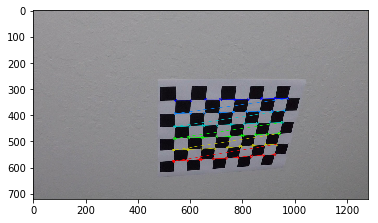

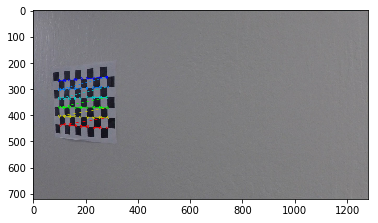

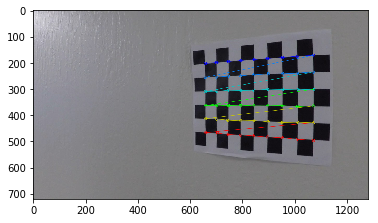

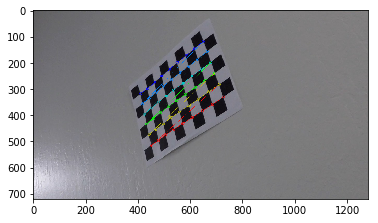

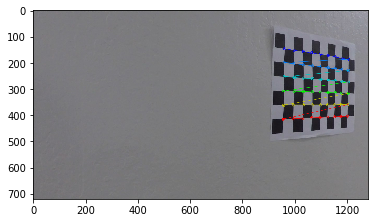

...

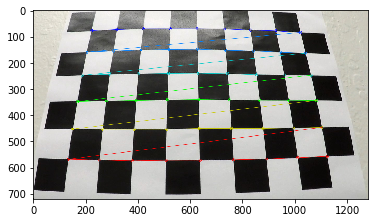

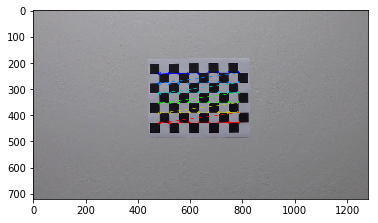

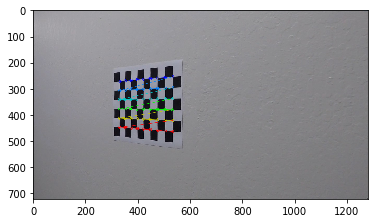

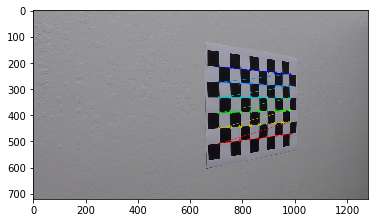

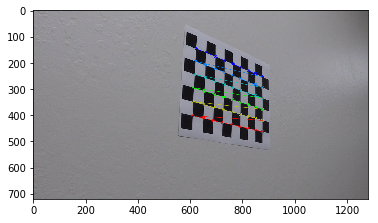

In [4]:
#run the function
objpoints, imgpoints = calibrate('camera_cal/', 'HLS&LAB-Sliding/camera_cal-output/')
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

# Apply undistortion - Save output to undistort-output

In [5]:
#takes output from previous function to undistort images
def undistort(img, ret, mtx, dist):

    dst = cv2.undistort(img, mtx, dist, None, mtx)
    return dst

C:\Anaconda\envs\carnd\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


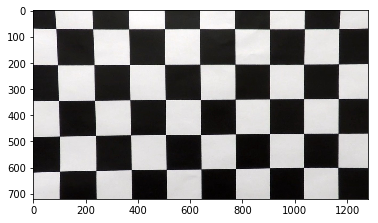

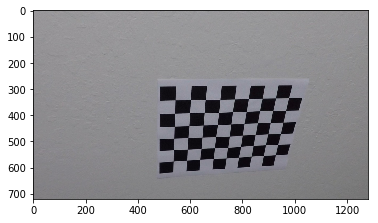

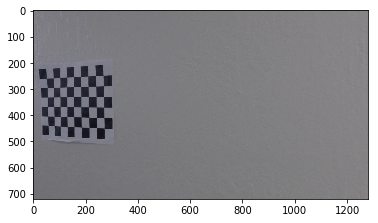

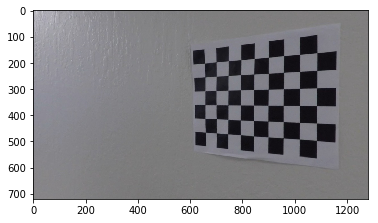

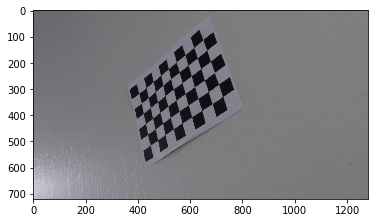

...

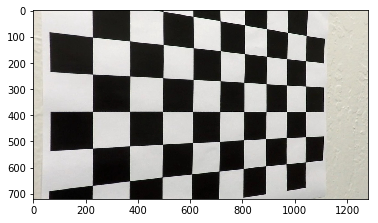

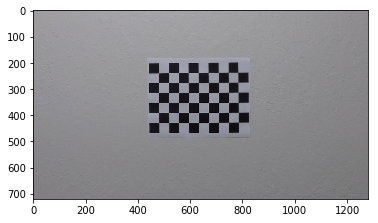

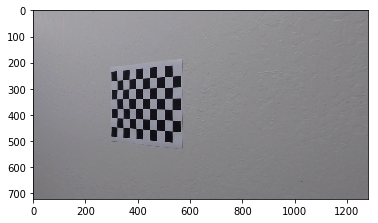

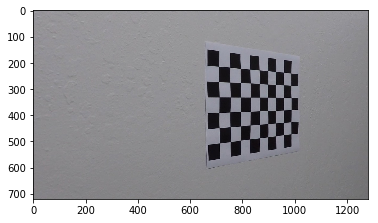

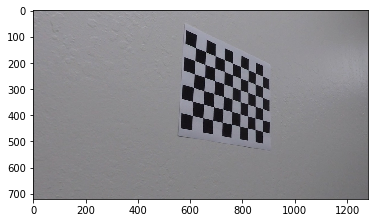

<Figure size 432x288 with 0 Axes>

In [6]:
images = glob.glob('camera_cal/*')
names = os.listdir('camera_cal/')
im_size = (mpimg.imread(images[0]).shape[1], mpimg.imread(images[0]).shape[0])
if not os.path.exists('HLS&LAB-Sliding/undistort-camera_cal-output/'):
    os.makedirs('HLS&LAB-Sliding/undistort-camera_cal-output/')
for indx, fname in enumerate(images):
    image = mpimg.imread(fname)
    dst = undistort(image, ret, mtx, dist)
    mpimg.imsave('HLS&LAB-Sliding/undistort-camera_cal-output/'+names[indx], dst)
    plt.imshow(dst)
    plt.figure()

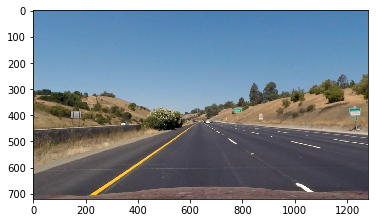

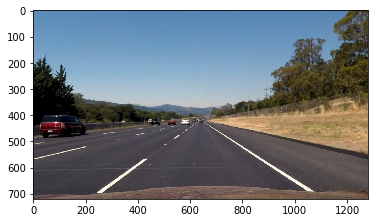

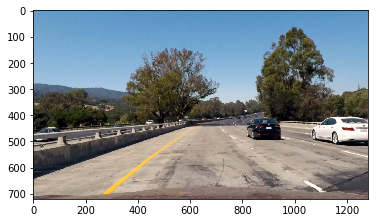

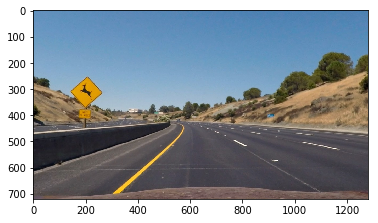

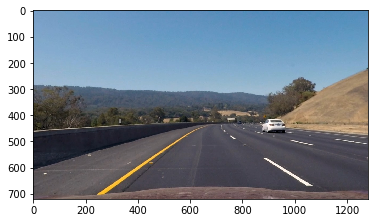

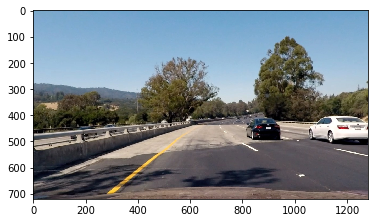

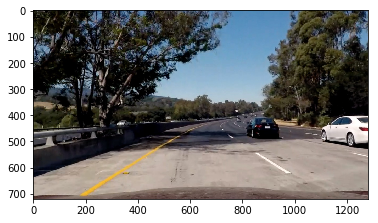

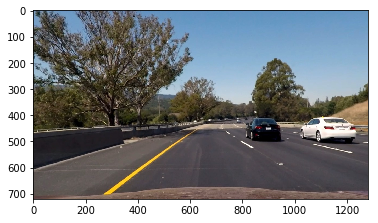

<Figure size 432x288 with 0 Axes>

In [7]:
images = glob.glob('test_images/*')
names = os.listdir('test_images/')
im_size = (mpimg.imread(images[0]).shape[1], mpimg.imread(images[0]).shape[0])
if not os.path.exists('HLS&LAB-Sliding/undistort-output/'):
    os.makedirs('HLS&LAB-Sliding/undistort-output/')
for indx, fname in enumerate(images):
    image = mpimg.imread(fname)
    dst = undistort(image, ret, mtx, dist)
    mpimg.imsave('HLS&LAB-Sliding/undistort-output/'+names[indx], dst)
    plt.imshow(dst)
    plt.figure()

# Apply Colour Transform - HLS and work on S channel; Gradient ( Derivative/Magnitude/Direction ) threshold and  to make binary image - Save output to binary-output

In [8]:
#I tried to use HLS, picking thresholded L and S channels then applying Derivative, Magnitude and Direction, but it didn't
#it did not give good results, thus I made use of the pipeline provided in the lessons

#there will be output images of my own pipeline in the output folder hls-output of which I will provide in the zipped file

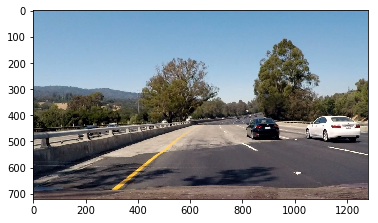

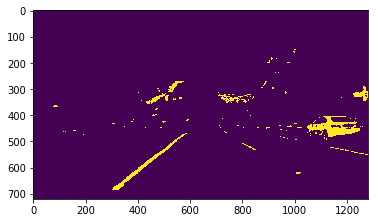

In [9]:
#testing my LUV&LAB gradient before definding function

image = mpimg.imread('test_images/test4.jpg')
lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
l_lab = lab[:,:,0]
a = lab[:,:,1]
b = lab[:,:,2]

luv = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
l_luv = luv[:,:,0]
u = luv[:,:,1]
v = luv[:,:,2]

sobelx = cv2.Sobel(l_luv, cv2.CV_64F, 1, 0) # Take the derivative in x
abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

l_luv_binary = np.zeros_like(scaled_sobel)
l_luv_binary[(l_luv >= 220) & (l_luv <= 255)] = 1


b_lab_binary = np.zeros_like(b)
b_lab_binary[(b >= 155) & (b <= 255)] = 1


combined = np.zeros_like(l_luv_binary)
combined[(l_luv_binary == 1) | (b_lab_binary == 1)] = 1
plt.imshow(image)
plt.figure()
plt.imshow(combined)

In [10]:
def binary(image):
    # 1) Convert to LAB and HLS color spaces to pick desired channels
    
    lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
    l_lab = lab[:,:,0]
    a = lab[:,:,1]
    b = lab[:,:,2]

    luv = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
    l_luv = luv[:,:,0]
    u = luv[:,:,1]
    v = luv[:,:,2]

    sobelx = cv2.Sobel(l_luv, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    
    h_hls = hls[:,:,0]
    l_hls = hls[:,:,1]
    s_hls = hls[:,:,2]
    
    hls_sobelx = cv2.Sobel(l_hls, cv2.CV_64F, 1, 0) # Take the derivative in x
    hls_abs_sobelx = np.absolute(hls_sobelx) # Absolute x derivative to accentuate lines away from horizontal
    hls_scaled_sobel = np.uint8(255*hls_abs_sobelx/np.max(hls_abs_sobelx))
    
    l_hls_binary = np.zeros_like(hls_scaled_sobel)
    l_hls_binary[(l_hls >= 200) & (l_hls <= 255)] = 1

    l_lab_sobelx = cv2.Sobel(l_lab, cv2.CV_64F, 1, 0) # Take the derivative in x
    l_lab_abs_sobelx = np.absolute(l_lab_sobelx) # Absolute x derivative to accentuate lines away from horizontal
    l_lab_scaled_sobel = np.uint8(255*l_lab_abs_sobelx/np.max(l_lab_abs_sobelx))
    
    b_lab_binary = np.zeros_like(b)
    b_lab_binary[(b >= 150) & (b <= 255)] = 1


    combined = np.zeros_like(l_hls_binary)
    combined[(l_hls_binary == 1) | (b_lab_binary == 1)] = 1
    
    return combined

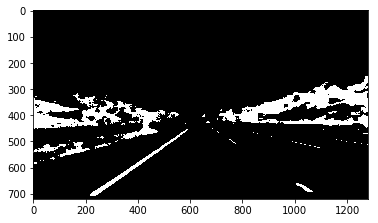

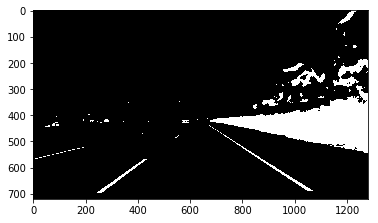

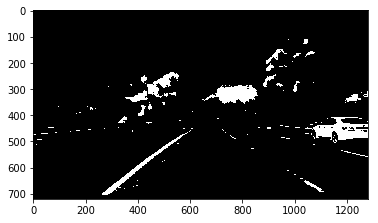

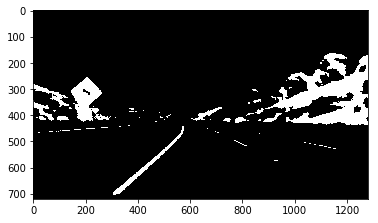

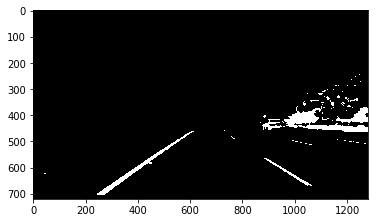

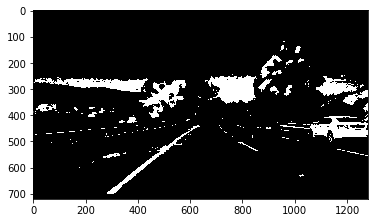

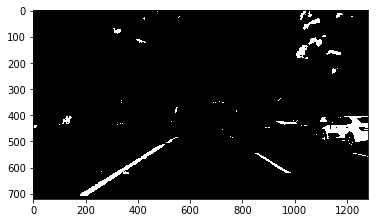

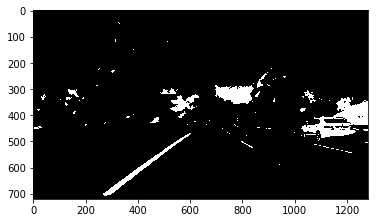

<Figure size 432x288 with 0 Axes>

In [11]:
images = glob.glob('HLS&LAB-Sliding/undistort-output/*')
names = os.listdir('test_images/')
if not os.path.exists('HLS&LAB-Sliding/HLS&LAB-output/'):
    os.makedirs('HLS&LAB-Sliding/HLS&LAB-output/')
for indx, fname in enumerate(images):
    image = mpimg.imread(fname)
    combined = binary(image)
    plt.imshow(combined, cmap='gray')
    plt.figure()
    mpimg.imsave('HLS&LAB-Sliding/HLS&LAB-output/'+names[indx], combined)

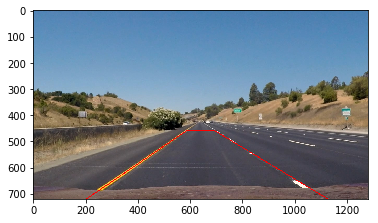

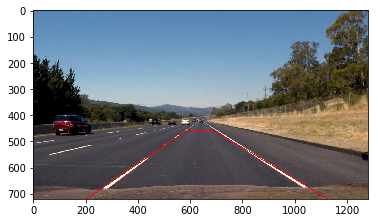

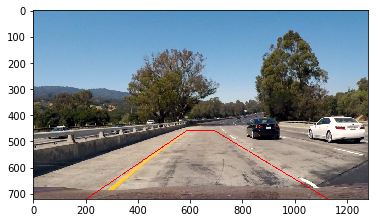

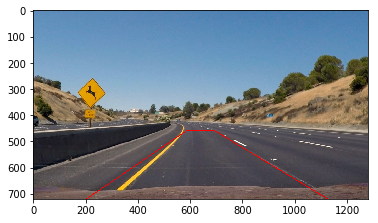

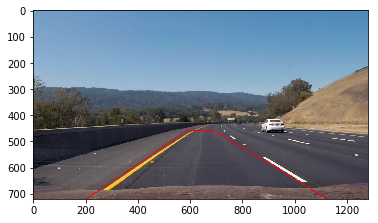

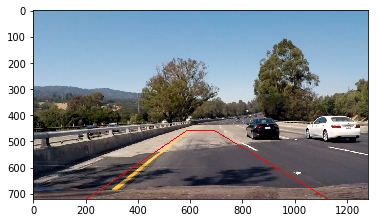

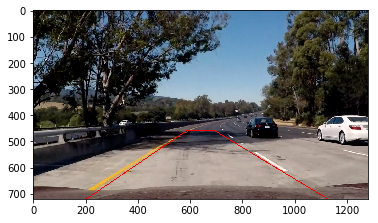

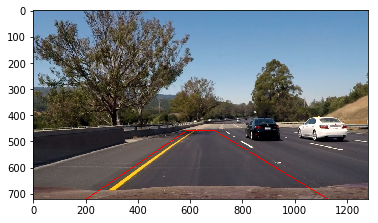

<Figure size 432x288 with 0 Axes>

In [12]:
images = glob.glob('test_images/*')
names = os.listdir('test_images/')
if not os.path.exists('HLS&LAB-Sliding/test_images_region-output/'):
    os.makedirs('HLS&LAB-Sliding/test_images_region-output/')
for indx, fname in enumerate(images):
    test_image = mpimg.imread(fname)
    left_top = (585, 460)
    left_topx, left_topy = left_top
    left_bot = (203, 720)
    left_botx, left_boty = left_bot
    right_bot = (1127,720)
    right_botx, right_boty = right_bot
    right_top = (695,460)
    right_topx, right_topy = right_top

    cv2.line(test_image, left_bot, left_top, [255, 0, 0], 2)
    cv2.line(test_image, left_top, right_top, [255, 0, 0], 2)
    cv2.line(test_image, right_bot, right_top, [255, 0, 0], 2)
    cv2.line(test_image, right_bot, left_bot, [255, 0, 0], 2)
    mpimg.imsave('HLS&LAB-Sliding/test_images_region-output/'+names[indx], test_image)
    plt.imshow(test_image)
    plt.figure()

#  Apply Bird-Eye-View - Save output to bird-output

In [13]:
#objpoints, imgpoints = calibrate('test_images/', 'test_images_cali-output/')
#ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, im_size, None, None)

In [14]:
def bird(img,nx, ny, mtx, dist):
    # Use the OpenCV undistort() function to remove distortion
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # Convert undistorted image to grayscale
    #gray = cv2.cvtColor(undist, cv2.COLOR_RGB2GRAY)
    # Search for corners in the grayscaled image
    left_top = (585, 460)
    left_topx, left_topy = left_top
    left_bot = (203, 720)
    left_botx, left_boty = left_bot
    right_bot = (1127,720)
    right_botx, right_boty = right_bot
    right_top = (695,460)
    right_topx, right_topy = right_top


    # Choose offset from image corners to plot detected corners
    # This should be chosen to present the result at the proper aspect ratio
    # My choice of 100 pixels is not exact, but close enough for our purpose here
    offset = 200 # offset for dst points
    # Grab the image shape
    img_size = (undist.shape[1], undist.shape[0])

        # For source points I'm grabbing the outer four detected corners
    src = np.float32([[left_topx, left_topy], [right_topx, right_topy], [right_botx, right_boty], [left_botx, left_boty]])
        # For destination points, I'm arbitrarily choosing some points to be
        # a nice fit for displaying our warped result 
        # again, not exact, but close enough for our purposes
    dst = np.float32([[320, 0], [960, 0], [960, 720],
                      [320, 720]])
        # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    M_Reverse = cv2.getPerspectiveTransform(dst, src)
        # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(undist, M, img_size)
    # Return the resulting image and matrix
    return warped, M, M_Reverse

# This block of code was modified once to save bird view of non-binary images, then wrote the original code we need.

In [15]:
#I run it once here, to store the M_Reverse
top_down, perspective_M, M_Reverse  = bird(combined, nx, ny, mtx, dist)

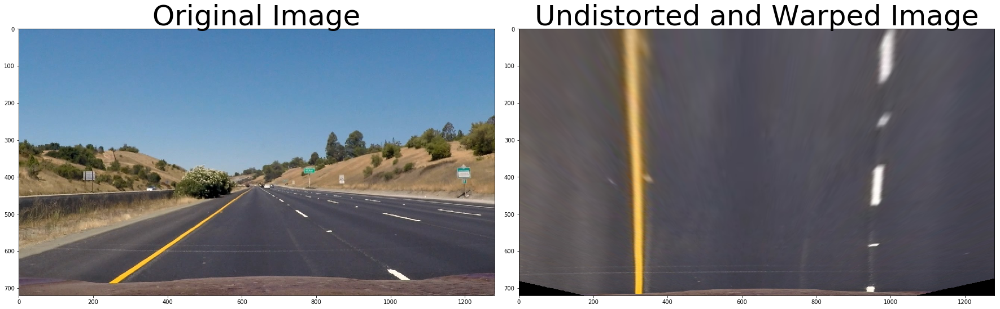

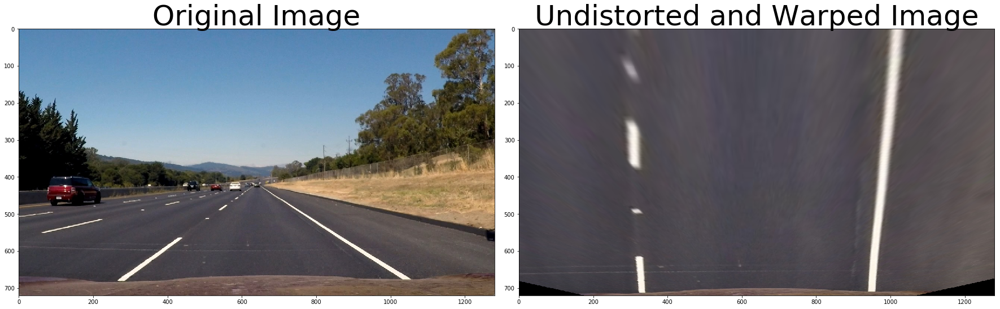

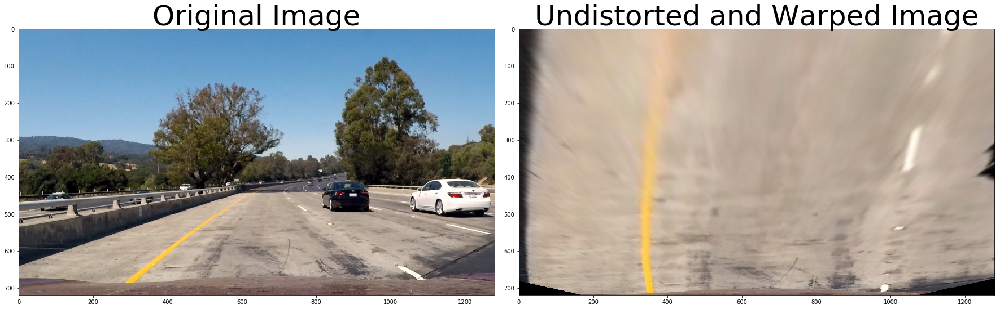

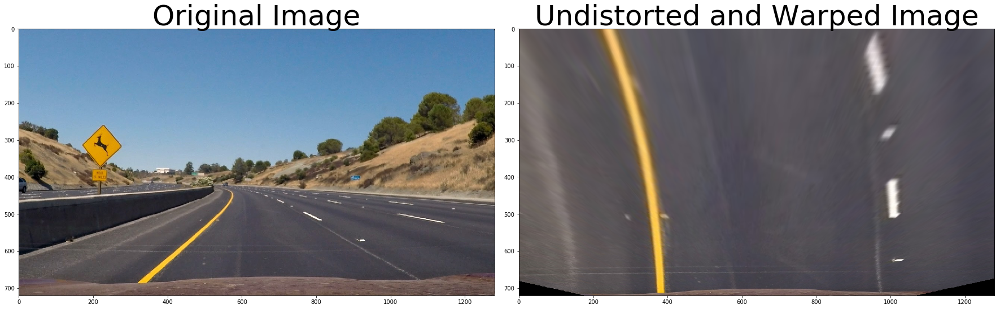

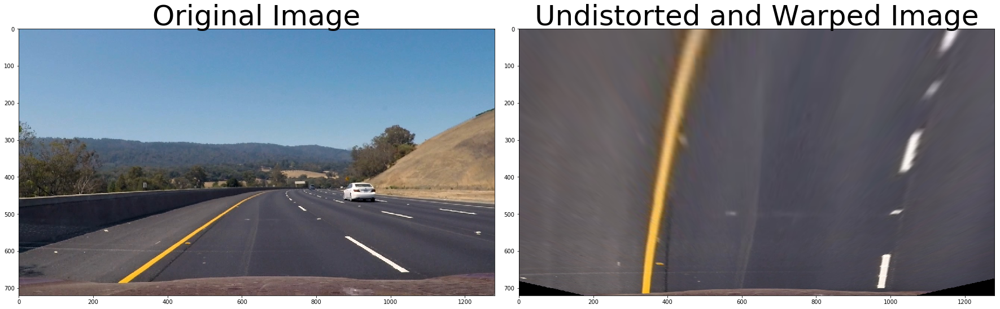

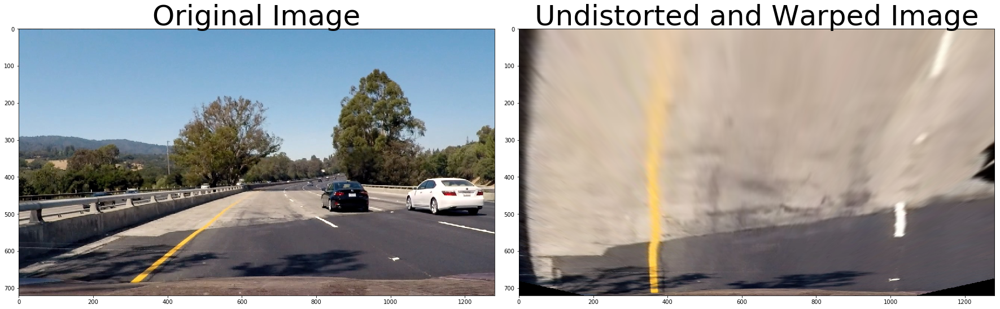

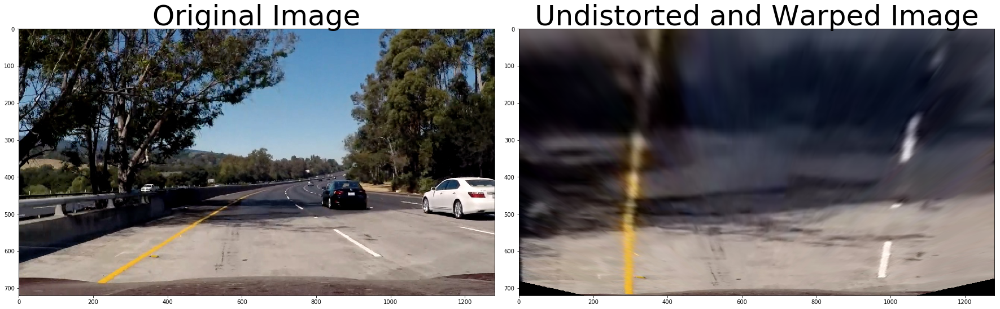

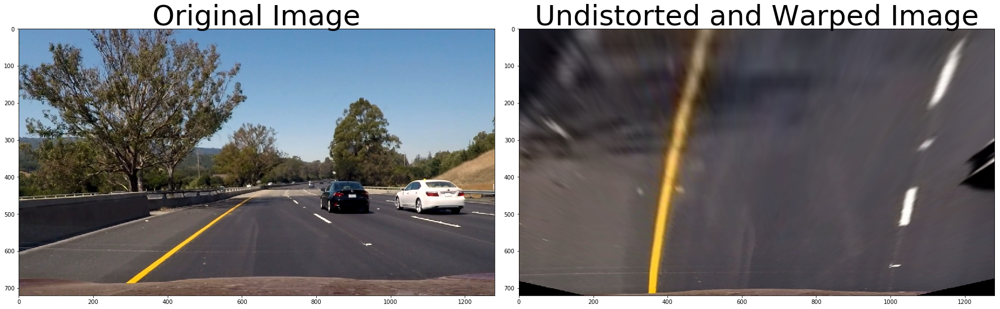

In [16]:
#to operate on non-binary images
images = glob.glob('test_images/*')
names = os.listdir('test_images/')
if not os.path.exists('HLS&LAB-Sliding/test_images-bird-output/'):
    os.makedirs('HLS&LAB-Sliding/test_images-bird-output/')
for indx, fname in enumerate(images):
    combined = mpimg.imread(fname)
    top_down, perspective_M, M_Reverse  = bird(combined, nx, ny, mtx, dist)
    mpimg.imsave('HLS&LAB-Sliding/test_images-bird-output/'+names[indx], top_down)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(mpimg.imread(fname), cmap='gray')
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(top_down, cmap='gray')
    ax2.set_title('Undistorted and Warped Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

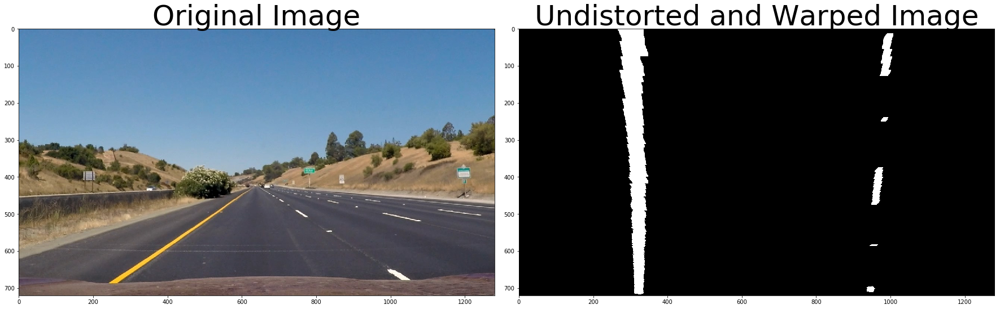

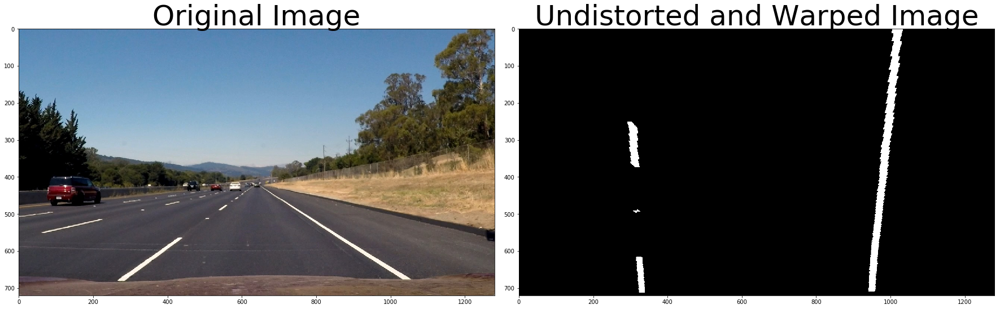

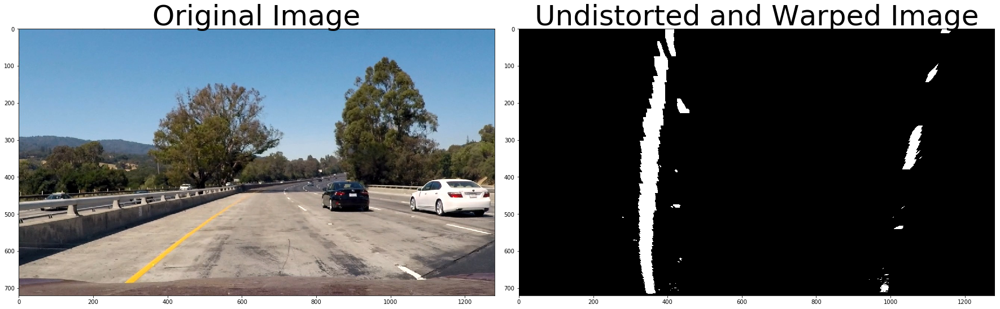

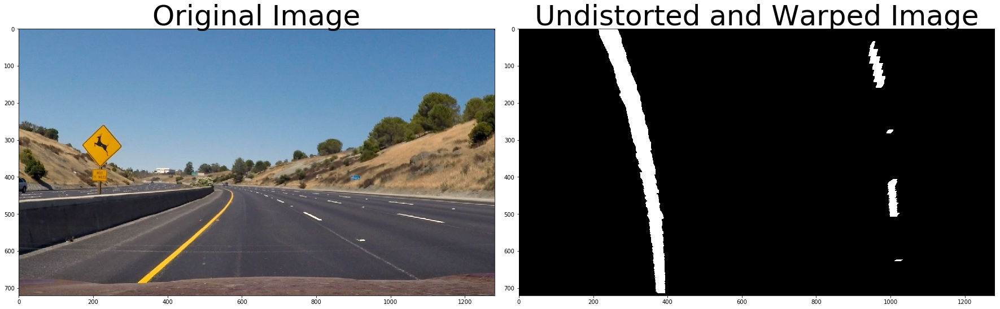

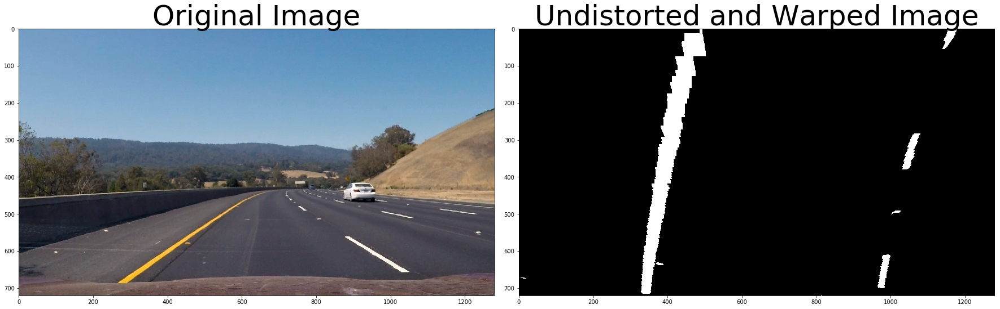

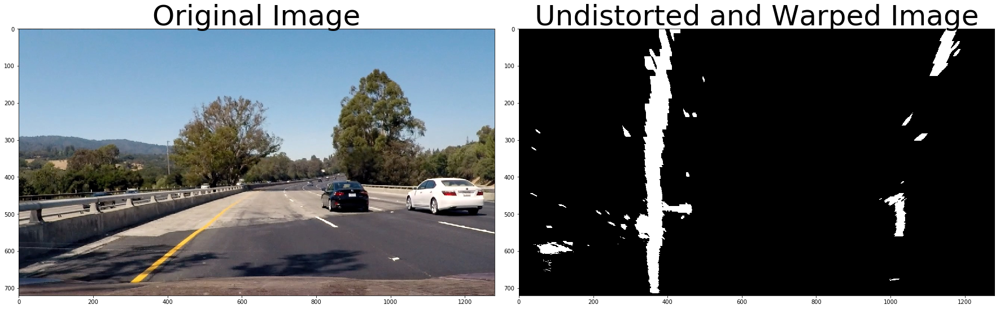

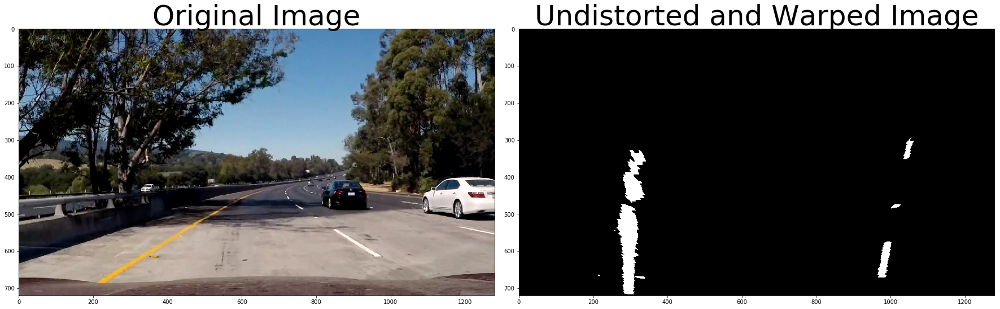

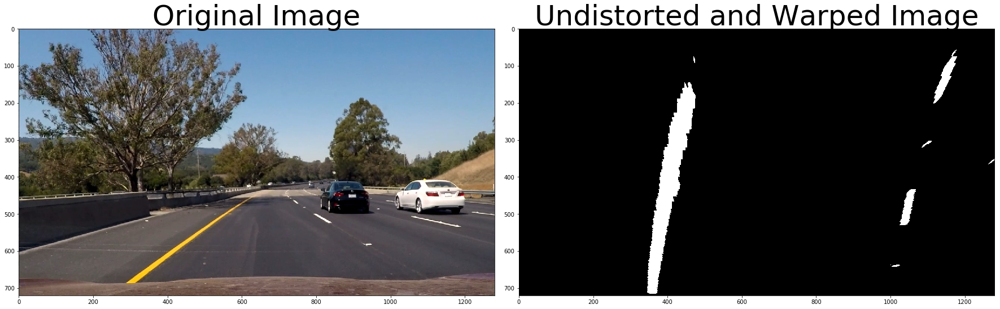

In [17]:
images = glob.glob('test_images/*')
names = os.listdir('test_images/')
if not os.path.exists('HLS&LAB-Sliding/test_images_binary-bird-output/'):
    os.makedirs('HLS&LAB-Sliding/test_images_binary-bird-output/')
for indx, fname in enumerate(images):
    image = mpimg.imread(fname)
    combined = binary(image)
    top_down, perspective_M, M_Reverse  = bird(combined, nx, ny, mtx, dist)
    mpimg.imsave('HLS&LAB-Sliding/test_images_binary-bird-output/'+names[indx], top_down)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(mpimg.imread(fname), cmap='gray')
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(top_down, cmap='gray')
    ax2.set_title('Undistorted and Warped Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Detect lane Pixel, Apply Sliding Window and Polyfit - Save output to detect-output

In [18]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
         #Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)

    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)



    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img

In [19]:
def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img, ploty, left_fitx, right_fitx

In [20]:
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/613 # meters per pixel in x dimension
def calculate_curvature(ploty, left_points, right_points):
    y_eval = np.max(ploty)
    # Fit a second order polynomial
    left_fit = np.polyfit(ploty, left_points, 2)
    right_fit = np.polyfit(ploty, right_points, 2)
    
    # Generate x and y values for plotting
    left_fit_ = left_fit[0]*y_eval**2 + left_fit[1]*y_eval + left_fit[2]
    right_fit_ = right_fit[0]*y_eval**2 + right_fit[1]*y_eval + right_fit[2]
    
    position = ((right_fit_ + left_fit_)/2)*xm_per_pix
    center = (1280/2)*xm_per_pix

    # Fit new polynomials for world space
    left_fit_rw = np.polyfit(ploty*ym_per_pix, left_points*xm_per_pix, 2)
    right_fit_rw = np.polyfit(ploty*ym_per_pix, right_points*xm_per_pix, 2)
    
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_rw[0]*y_eval*ym_per_pix + left_fit_rw[1])**2)**1.5) / np.absolute(2*left_fit_rw[0])
    right_curverad = ((1 + (2*right_fit_rw[0]*y_eval*ym_per_pix + right_fit_rw[1])**2)**1.5) / np.absolute(2*right_fit_rw[0])

    return left_curverad, right_curverad, position, center

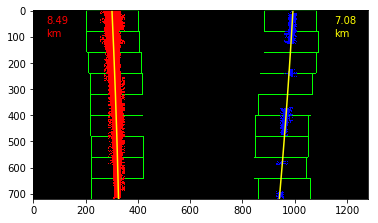

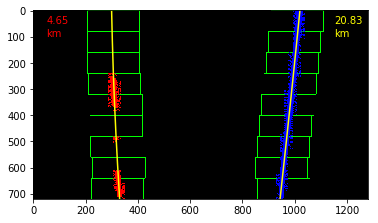

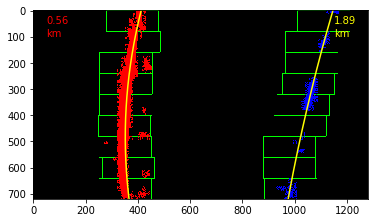

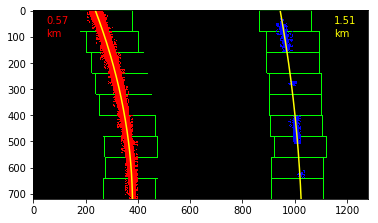

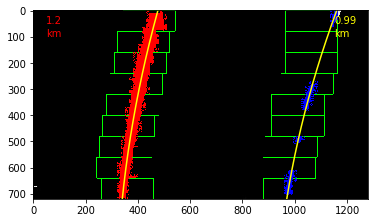

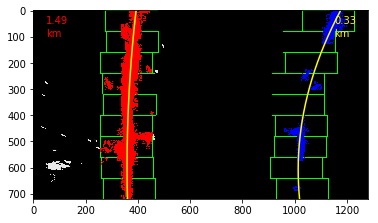

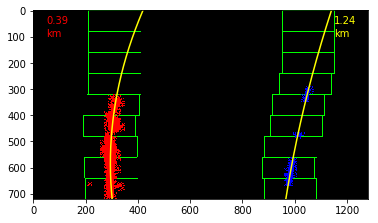

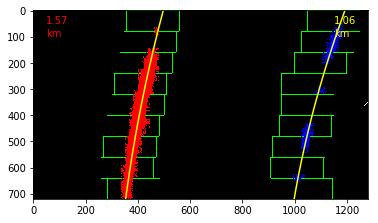

<Figure size 432x288 with 0 Axes>

In [21]:
images = glob.glob('HLS&LAB-Sliding/test_images_binary-bird-output/*')
names = os.listdir('HLS&LAB-Sliding/test_images_binary-bird-output/')
if not os.path.exists('HLS&LAB-Sliding/test_images_poly-output/'):
    os.makedirs('HLS&LAB-Sliding/test_images_poly-output/')
for indx, fname in enumerate(images):
    img = mpimg.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_HLS2RGB)
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    out_img, ploty, left_fit, right_fit = fit_polynomial(img)
    left_curverad, right_curverad, position, center = calculate_curvature(ploty, left_fit, right_fit)
    
    mpimg.imsave('HLS&LAB-Sliding/test_images_poly-output/'+names[indx], out_img)
    plt.imshow(out_img)
    plt.text(50, 50, np.round(left_curverad/1000, 2), color='red')
    plt.text(50, 100, 'km', color='red')
    plt.text(1150, 50, np.round(right_curverad/1000, 2), color='yellow')
    plt.text(1150, 100, 'km', color='yellow')
    plt.figure()

# Convolution Tests

In [22]:
window_width = 50 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 40 # How much to slide left and right for searching

def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    left_points = []
    right_points = []
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    left_points.append(l_center)
    right_points.append(r_center)
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
    # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))
        left_points.append(l_center)
        right_points.append(r_center)
    return window_centroids, left_points, right_points

# Output of Convolution test and Curvature Calculation

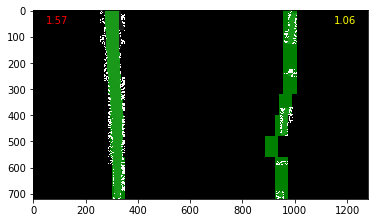

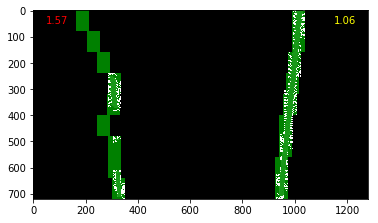

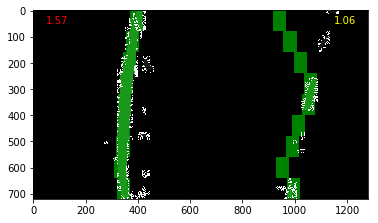

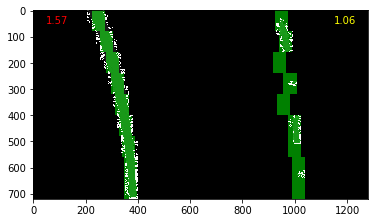

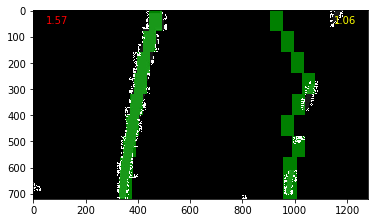

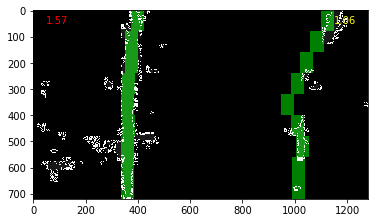

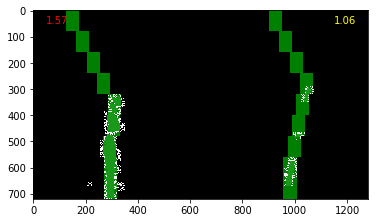

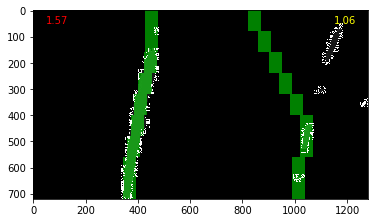

<Figure size 432x288 with 0 Axes>

In [23]:
images = glob.glob('HLS&LAB-Sliding/test_images_binary-bird-output/*')
names = os.listdir('HLS&LAB-Sliding/test_images_binary-bird-output/')
if not os.path.exists('HLS&LAB-Sliding/test_images_convolution-output/'):
    os.makedirs('HLS&LAB-Sliding/test_images_convolution-output/')
for indx, fname in enumerate(images):
    image = mpimg.imread(fname)
    image = cv2.cvtColor(image, cv2.COLOR_HLS2RGB)
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    window_centroids, left_points, right_points = find_window_centroids(image, window_width, window_height, margin)
    #left_curverad, right_curverad, position, center = calculate_curvature(left_points, right_points)
    
# Now our radius of curvature is in meters

# If we found any window centers
    if len(window_centroids) > 0:

    # Points used to draw all the left and right windows
        l_points = np.zeros_like(image)
        r_points = np.zeros_like(image)

    # Go through each level and draw the windows 	
        for level in range(0,len(window_centroids)):
        # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,image,window_centroids[level][0],level)
            r_mask = window_mask(window_width,window_height,image,window_centroids[level][1],level)
        # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

    # Draw the results
        template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template) # create a zero color channel
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        warpage= np.dstack((image, image, image))*255 # making the original road pixels 3 color channels
        output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
 
    # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((image,image,image)),np.uint8)
    mpimg.imsave('HLS&LAB-Sliding/test_images_convolution-output/'+names[indx], output)
    plt.imshow(output)
    plt.text(50, 50, np.round(left_curverad/1000, 2), color='red')
    plt.text(1150, 50, np.round(right_curverad/1000, 2), color='yellow')
    #plt.ylabel(left_curverad/1000)
    #plt.xlabel(right_curverad/1000)
    plt.figure()

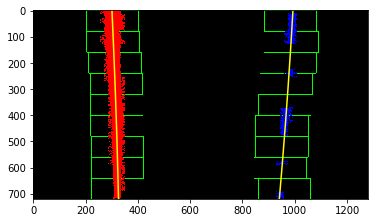

In [24]:
test_undist = mpimg.imread('HLS&LAB-Sliding/undistort-output/straight_lines1.jpg')
test_binary_bird = mpimg.imread('HLS&LAB-Sliding/test_images_binary-bird-output/straight_lines1.jpg')
test_bird = mpimg.imread('HLS&LAB-Sliding/test_images-bird-output/straight_lines1.jpg')
test_warped = mpimg.imread('HLS&LAB-Sliding/test_images_poly-output/straight_lines1.jpg')
img = cv2.cvtColor(test_binary_bird, cv2.COLOR_HLS2RGB)
img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
out_img, ploty, left_fit, right_fit = fit_polynomial(img)
plt.imshow(out_img)

# Transform back to normal image, undoing bird-eye-view

In [25]:
def unbird_lane(image, left_fit, right_fit, Minv):

    ploty = np.linspace(0, img.shape[0] , img.shape[0])
    color_warp = np.zeros_like(image).astype(np.uint8)

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fit, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fit, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (255,0, 0))
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    lane = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    unwarped = cv2.addWeighted(image, 1, lane, 0.3, 0)
    return unwarped

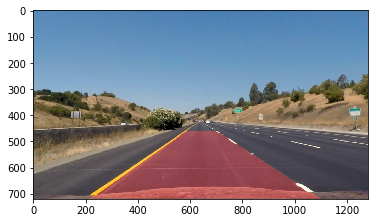

In [26]:
output = unbird_lane(test_undist, left_fit, right_fit, M_Reverse)
plt.imshow(output)

# Output Curvature Radius and Other info on images - Save output to image-output

# Pipeline on one of images to show the process and result on each step

In [27]:
#on top left, I plot the radius of left_curve in red colour
#on top right, I plot the radius of right_curve in yellow colour
#in the middle of image, I plot the position of vehicle according to center; 
#if the value is negative, it means the vehicle is <value> meters away to the left of center
#if the value is positive, it means the vehicle is <value> meters away to the right of corner

#EDITED: If condition to show absolute value and add text according to 0-threshold. according to previous rules

In [28]:
#The next scripts were edited once to save results as test-sample to be provided then made into a pipeline again

-691.5926527696727


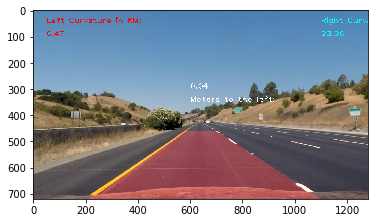

In [29]:
if not os.path.exists('HLS&LAB-Sliding/output_images/pipeline_image_test/'):
    os.makedirs('HLS&LAB-Sliding/output_images/pipeline_image_test/')
image = mpimg.imread('test_images/straight_lines1.jpg')
image_undist = undistort(image, ret, mtx, dist)
#mpimg.imsave('output_images/pipeline_image_test/straight_lines1-undist.jpg', image_undist)
combined = binary(image_undist)
#mpimg.imsave('output_images/pipeline_image_test/straight_lines1-binary.jpg', combined)
img, perspective_M, M_Reverse  = bird(combined, nx, ny, mtx, dist)
#mpimg.imsave('output_images/pipeline_image_test/straight_lines1-binary-bird.jpg', img)
#img_bird, perspective_M, M_Reverse  = bird(image_undist, nx, ny, mtx, dist)
#mpimg.imsave('output_images/pipeline_image_test/straight_lines1-bird.jpg', img_bird)
out_img, ploty, left_fit, right_fit = fit_polynomial(img)
#plt.imshow(out_img)
#plt.figure()
plt.gcf().clear()
#mpimg.imsave('output_images/pipeline_image_test/straight_lines1-polyfit.jpg', out_img)
left_curverad, right_curverad, position, center = calculate_curvature(ploty, left_fit, right_fit)
left_curv = np.round(left_curverad/1000, 2)
right_curv = np.round(right_curverad/1000, 2)
distance = np.absolute(np.round(position-center, 2))
output = unbird_lane(image_undist, left_fit, right_fit, M_Reverse)
cv2.putText(output, 'Left Curvature in KM:', (50, 50),1, 2, (255, 0, 0), 2)
cv2.putText(output, str(left_curv), (50, 100),1, 2, (255, 0, 0), 2)
cv2.putText(output, 'Right Curvature in KM:', (1100, 50), 1, 2, (0, 255, 255), 2)
cv2.putText(output, str(right_curv), (1100, 100),1, 2, (0, 255, 255), 2)
cv2.putText(output, str(distance), (600, 300),1, 2, (255, 255, 255), 2)
if position-center > 0:
    cv2.putText(output, 'Meters to the right:', (600, 350),1, 2, (255, 255, 255), 2)
else:
    cv2.putText(output, 'Meters to the left:', (600, 350),1, 2, (255, 255, 255), 2)
plt.imshow(output)
mpimg.imsave('HLS&LAB-Sliding/output_images/pipeline_image_test/straight_lines1-output.jpg', output)
width = left_fit[0] - right_fit[0]
print(width)

In [30]:
def process_image(image):
    image_undist = undistort(image, ret, mtx, dist)
#mpimg.imsave('output_images/pipeline_image_test/straight_lines1-undist.jpg', image_undist)
    combined = binary(image_undist)
#mpimg.imsave('output_images/pipeline_image_test/straight_lines1-binary.jpg', combined)
    img, perspective_M, M_Reverse  = bird(combined, nx, ny, mtx, dist)
#mpimg.imsave('output_images/pipeline_image_test/straight_lines1-binary-bird.jpg', img)
#img_bird, perspective_M, M_Reverse  = bird(image_undist, nx, ny, mtx, dist)
#mpimg.imsave('output_images/pipeline_image_test/straight_lines1-bird.jpg', img_bird)
    out_img, ploty, left_fit, right_fit = fit_polynomial(img)
#plt.imshow(out_img)
#plt.figure()
    plt.gcf().clear()
#mpimg.imsave('output_images/pipeline_image_test/straight_lines1-polyfit.jpg', out_img)
    left_curverad, right_curverad, position, center = calculate_curvature(ploty, left_fit, right_fit)
    output = unbird_lane(image_undist, left_fit, right_fit, M_Reverse)
    
    left_curv = np.round(left_curverad/1000, 2)
    right_curv = np.round(right_curverad/1000, 2)
    distance = np.round(np.absolute(position-center), 2)
    
    cv2.putText(output, 'Left Curvature KM:', (50, 50),1, 2, (255, 0, 0), 2)
    cv2.putText(output, str(left_curv), (50, 100),1, 2, (255, 0, 0), 2)
    cv2.putText(output, 'Right Curvature KM:', (1100, 50), 1, 2, (0, 255, 255), 2)
    cv2.putText(output, str(right_curv), (1100, 100),1, 2, (0, 255, 255), 2)
    cv2.putText(output, str(distance), (600, 300),1, 2, (255, 255, 255), 2)
    if position-center > 0:
        cv2.putText(output, 'Meters to the right:', (600, 350),1, 2, (255, 255, 255), 2)
    else:
        cv2.putText(output, 'Meters to the left:', (600, 350),1, 2, (255, 255, 255), 2)
    return output
#mpimg.imsave('output_images/pipeline_image_test/straight_lines1-output.jpg', output)

In [31]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [32]:

## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds

clip1 = VideoFileClip("project_video.mp4")
clip_output = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time clip_output.write_videofile('HLS&LAB-Sliding/project_video-output.mp4', audio=False)

[MoviePy] >>>> Building video HLS&LAB-Sliding/project_video-output.mp4
[MoviePy] Writing video HLS&LAB-Sliding/project_video-output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [04:24<00:00,  4.76it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: HLS&LAB-Sliding/project_video-output.mp4 

Wall time: 4min 25s


<Figure size 432x288 with 0 Axes>

HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format('HLS&LAB-Sliding/project_video-output.mp4'))

# Challenge Video


In [33]:

## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("challenge_video.mp4")
clip_output = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time clip_output.write_videofile('HLS&LAB-Sliding/challenge_video-output.mp4', audio=False)


[MoviePy] >>>> Building video HLS&LAB-Sliding/challenge_video-output.mp4
[MoviePy] Writing video HLS&LAB-Sliding/challenge_video-output.mp4


  1%|█                                                                                 | 6/485 [00:01<01:35,  5.01it/s]

TypeError: expected non-empty vector for x

<Figure size 432x288 with 0 Axes>

In [34]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format('challenge_video-output.mp4'))

# Challenge2 Video

In [35]:

## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("harder_challenge_video.mp4")
clip_output = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time clip_output.write_videofile('HLS&LAB-Sliding/harder_challenge_video-output.mp4', audio=False)

[MoviePy] >>>> Building video HLS&LAB-Sliding/harder_challenge_video-output.mp4
[MoviePy] Writing video HLS&LAB-Sliding/harder_challenge_video-output.mp4



  6%|████▍                                                                           | 67/1200 [00:16<04:32,  4.15it/s]


 11%|████████▉                                                                      | 135/1200 [00:31<04:05,  4.34it/s]


 17%|█████████████▎                                                                 | 203/1200 [00:44<03:40,  4.51it/s]


 23%|█████████████████▊                                                             | 271/1200 [01:00<03:28,  4.46it/s]


 28%|██████████████████████▎                                                        | 339/1200 [01:15<03:11,  4.50it/s]


 34%|██████████████████████████▊                                                    | 407/1200 [01:33<03:02,  4.35it/s]


 40%|███████████████████████████████▎                                               | 475/1200 [01:51<02:49,  4.27it/s]


 45%|███████████████████████████████████▋                                           | 543/1200 [02:05<02:32,  4.32it/s]


 49%|██████████████████████████████████████▉                                        | 591/1200 [02:15<02:20,  4.35it/s]

TypeError: expected non-empty vector for x

<Figure size 432x288 with 0 Axes>

In [36]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format('harder_challenge_video-output.mp4'))